# Self-Driving Car Engineer Nanodegree

## Deep Learning

## Project: Build a Traffic Sign Recognition Classifier

In this notebook, a template is provided for you to implement your functionality in stages, which is required to successfully complete this project. If additional code is required that cannot be included in the notebook, be sure that the Python code is successfully imported and included in your submission if necessary. 

> **Note**: Once you have completed all of the code implementations, you need to finalize your work by exporting the iPython Notebook as an HTML document. Before exporting the notebook to html, all of the code cells need to have been run so that reviewers can see the final implementation and output. You can then export the notebook by using the menu above and navigating to  \n",
    "**File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission. 

In addition to implementing code, there is a writeup to complete. The writeup should be completed in a separate file, which can be either a markdown file or a pdf document. There is a [write up template](https://github.com/udacity/CarND-Traffic-Sign-Classifier-Project/blob/master/writeup_template.md) that can be used to guide the writing process. Completing the code template and writeup template will cover all of the [rubric points](https://review.udacity.com/#!/rubrics/481/view) for this project.

The [rubric](https://review.udacity.com/#!/rubrics/481/view) contains "Stand Out Suggestions" for enhancing the project beyond the minimum requirements. The stand out suggestions are optional. If you decide to pursue the "stand out suggestions", you can include the code in this Ipython notebook and also discuss the results in the writeup file.


>**Note:** Code and Markdown cells can be executed using the **Shift + Enter** keyboard shortcut. In addition, Markdown cells can be edited by typically double-clicking the cell to enter edit mode.

---
## Step 0: Load The Data

In [1]:
# Load pickled data
import pickle

# TODO: Fill this in based on where you saved the training and testing data

training_file = "./traffic-signs-data/train.p"
validation_file= "./traffic-signs-data/valid.p"
testing_file = "./traffic-signs-data/test.p"

with open(training_file, mode='rb') as f:
    train = pickle.load(f)
with open(validation_file, mode='rb') as f:
    valid = pickle.load(f)
with open(testing_file, mode='rb') as f:
    test = pickle.load(f)
    
X_train, Y_train = train['features'], train['labels']
X_valid, Y_valid = valid['features'], valid['labels']
X_test, Y_test = test['features'], test['labels']

---

## Step 1: Dataset Summary & Exploration

The pickled data is a dictionary with 4 key/value pairs:

- `'features'` is a 4D array containing raw pixel data of the traffic sign images, (num examples, width, height, channels).
- `'labels'` is a 1D array containing the label/class id of the traffic sign. The file `signnames.csv` contains id -> name mappings for each id.
- `'sizes'` is a list containing tuples, (width, height) representing the original width and height the image.
- `'coords'` is a list containing tuples, (x1, y1, x2, y2) representing coordinates of a bounding box around the sign in the image. **THESE COORDINATES ASSUME THE ORIGINAL IMAGE. THE PICKLED DATA CONTAINS RESIZED VERSIONS (32 by 32) OF THESE IMAGES**

Complete the basic data summary below. Use python, numpy and/or pandas methods to calculate the data summary rather than hard coding the results. For example, the [pandas shape method](http://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.shape.html) might be useful for calculating some of the summary results. 

### Provide a Basic Summary of the Data Set Using Python, Numpy and/or Pandas

In [2]:
### Replace each question mark with the appropriate value. 
### Use python, pandas or numpy methods rather than hard coding the results

# TODO: Number of training examples
n_train = len(X_train)

# TODO: Number of validation examples
n_validation = len(X_valid)

# TODO: Number of testing examples.
n_test = len(X_test)

# TODO: What's the shape of an traffic sign image?
image_shape = X_train[0].shape

# TODO: How many unique classes/labels there are in the dataset.
n_classes = len(set(Y_train))

print("Number of training examples =", n_train)
print("Number of testing examples =", n_test)
print("Image data shape =", image_shape)
print("Number of classes =", n_classes)
print("Number of validation =", n_validation)

Number of training examples = 34799
Number of testing examples = 12630
Image data shape = (32, 32, 3)
Number of classes = 43
Number of validation = 4410


### Include an exploratory visualization of the dataset

Visualize the German Traffic Signs Dataset using the pickled file(s). This is open ended, suggestions include: plotting traffic sign images, plotting the count of each sign, etc. 

The [Matplotlib](http://matplotlib.org/) [examples](http://matplotlib.org/examples/index.html) and [gallery](http://matplotlib.org/gallery.html) pages are a great resource for doing visualizations in Python.

**NOTE:** It's recommended you start with something simple first. If you wish to do more, come back to it after you've completed the rest of the sections. It can be interesting to look at the distribution of classes in the training, validation and test set. Is the distribution the same? Are there more examples of some classes than others?

In [3]:
### Data exploration visualization code goes here.
### Feel free to use as many code cells as needed.
import matplotlib.pyplot as plt
from collections import Counter
import numpy as np
# Visualizations will be shown in the notebook.
%matplotlib inline

def show_traffic_stats(x, y, title):
    plt.style.use('seaborn-darkgrid')
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.barh(x, y)
    ax.set_yticks(x)
    labels = ax.get_xticklabels()
    plt.setp(labels, rotation=45, horizontalalignment='right', fontsize=12)
    labels = ax.get_yticklabels()
    plt.setp(labels, fontsize=12)
    plt.xlabel('Count of each sign', fontsize=18)
    plt.ylabel('Number of sign classes', fontsize=18)
    plt.title(title, fontsize=20)
    plt.show()
    
    
def images_show(rows, cols, image, cmap=None):
    if image.ndim == 3:
        aspect = image.shape[0] / float(image.shape[1])
    else:
        aspect = image[0].shape[0] / float(image[0].shape[1])
    n = rows  # number of rows
    m = cols  # numberof columns
    bottom = 0
    left = 0
    top = 1. - bottom
    right = 1. - left
    # widthspace, relative to subplot size
    wspace = 0.05 # set to zero for no spacing
    hspace = wspace / float(aspect)
    figheight = rows/3 + (rows*(left+right+hspace))
    figwidth = cols/3 + (cols*(top+bottom+wspace))
    
    fig, axes = plt.subplots(nrows=n, ncols=m, figsize=(figwidth, figheight))
    plt.subplots_adjust(top=top, bottom=bottom, left=left, right=right,
                        wspace=wspace, hspace=hspace)

    if image.ndim == 3:
        if cmap == 'gray' or image.shape[-1] == 1:
            image = image.reshape(image.shape[0], image.shape[1])
        plt.imshow(image, interpolation="BILINEAR", cmap=cmap)
        plt.axis('off')
    else:
        for (ax, i) in zip(axes.flatten(), range(len(axes.flatten()))):
            if i<image.shape[0]:
                if cmap == 'gray' or image.shape[-1] == 1:
                    shape = (image[i].shape[0], image[i].shape[1])
                    ax.imshow(image[i].reshape(shape), interpolation="BILINEAR", cmap=cmap)
                else:
                    ax.imshow(image[i], interpolation="BILINEAR", cmap=cmap)
            ax.axis('off')
    plt.show()

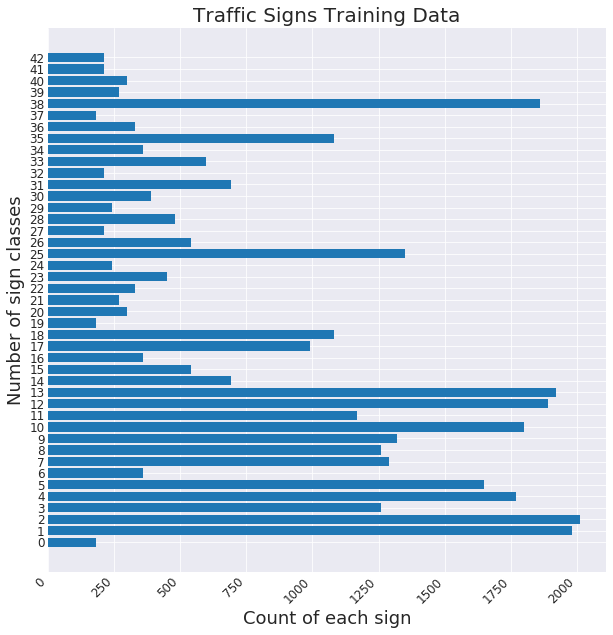

In [4]:
x, y = np.unique(Y_train, return_counts = True)
show_traffic_stats(x, y, "Traffic Signs Training Data")

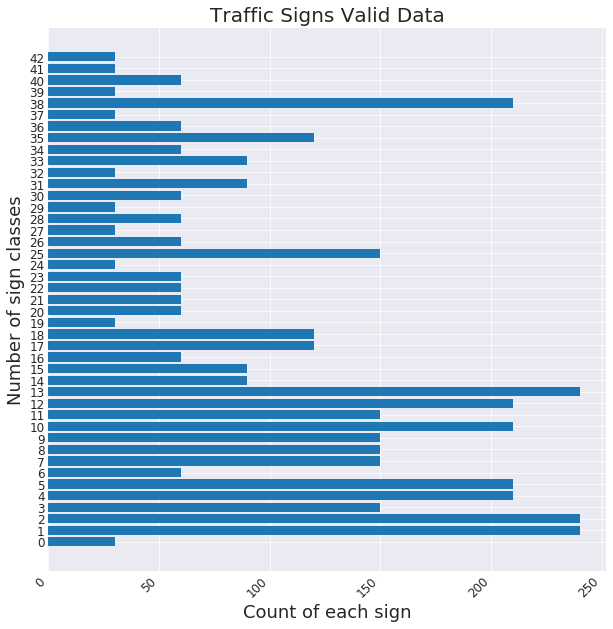

In [5]:
x, y = np.unique(Y_valid, return_counts = True)
show_traffic_stats(x, y, "Traffic Signs Valid Data")

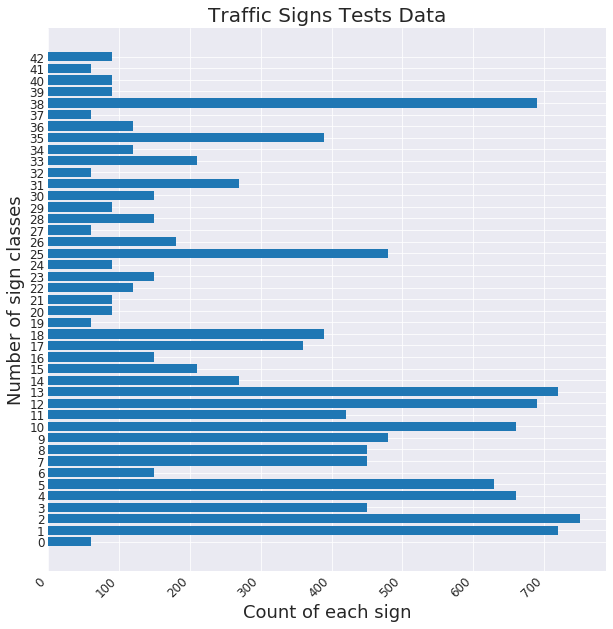

In [6]:
x, y = np.unique(Y_test, return_counts = True)
show_traffic_stats(x, y, "Traffic Signs Tests Data")

### Plot traffic sign images

Class 0: Speed limit (20km/h)                                                             Number of images:180


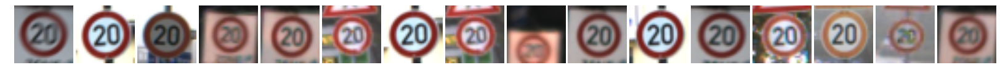

Class 1: Speed limit (30km/h)                                                             Number of images:1980


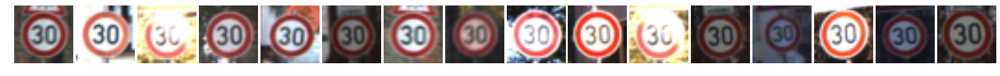

Class 2: Speed limit (50km/h)                                                             Number of images:2010


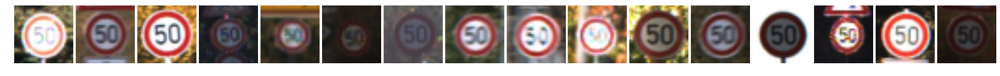

Class 3: Speed limit (60km/h)                                                             Number of images:1260


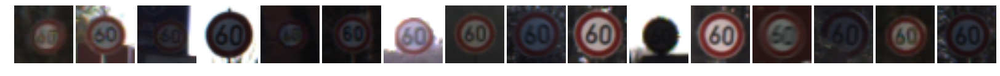

Class 4: Speed limit (70km/h)                                                             Number of images:1770


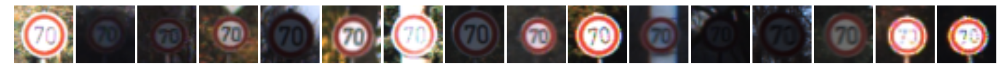

Class 5: Speed limit (80km/h)                                                             Number of images:1650


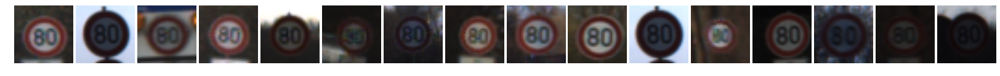

Class 6: End of speed limit (80km/h)                                                      Number of images:360


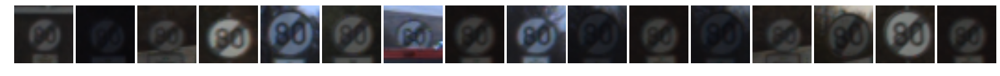

Class 7: Speed limit (100km/h)                                                            Number of images:1290


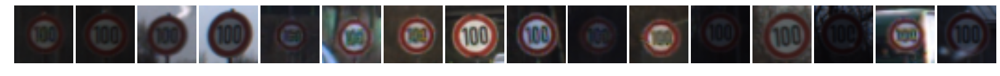

Class 8: Speed limit (120km/h)                                                            Number of images:1260


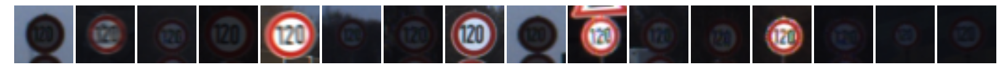

Class 9: No passing                                                                       Number of images:1320


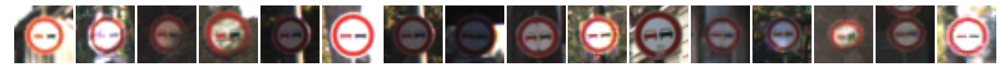

Class 10: No passing for vehicles over 3.5 metric tons                                     Number of images:1800


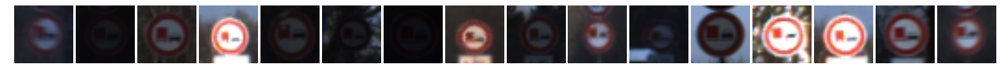

Class 11: Right-of-way at the next intersection                                            Number of images:1170


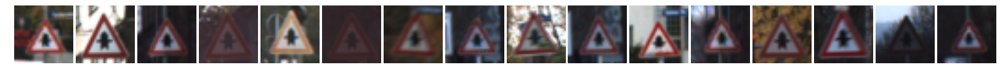

Class 12: Priority road                                                                    Number of images:1890


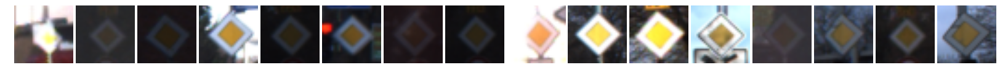

Class 13: Yield                                                                            Number of images:1920


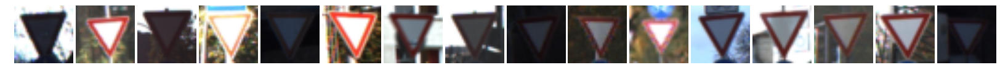

Class 14: Stop                                                                             Number of images:690


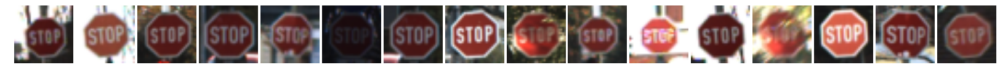

Class 15: No vehicles                                                                      Number of images:540


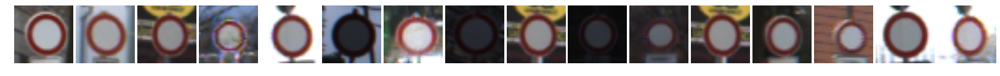

Class 16: Vehicles over 3.5 metric tons prohibited                                         Number of images:360


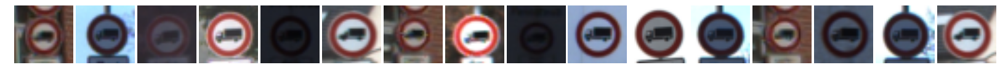

Class 17: No entry                                                                         Number of images:990


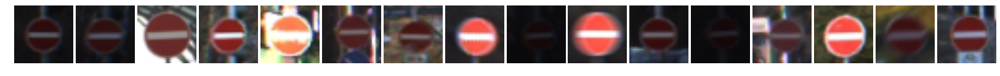

Class 18: General caution                                                                  Number of images:1080


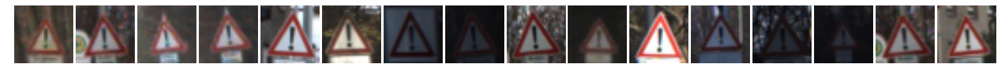

Class 19: Dangerous curve to the left                                                      Number of images:180


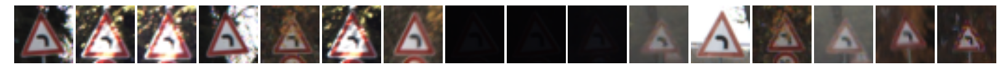

Class 20: Dangerous curve to the right                                                     Number of images:300


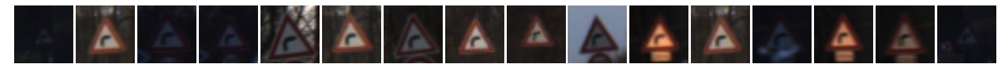

Class 21: Double curve                                                                     Number of images:270


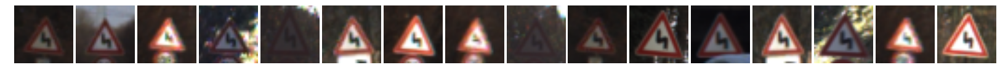

Class 22: Bumpy road                                                                       Number of images:330


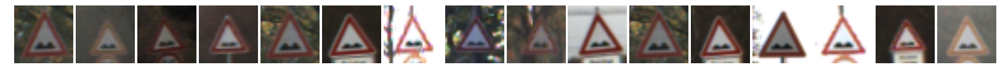

Class 23: Slippery road                                                                    Number of images:450


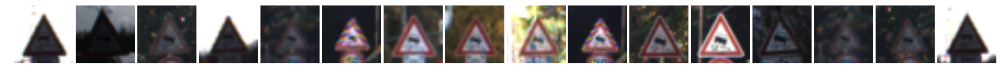

Class 24: Road narrows on the right                                                        Number of images:240


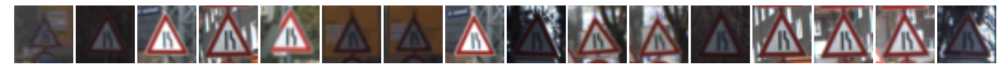

Class 25: Road work                                                                        Number of images:1350


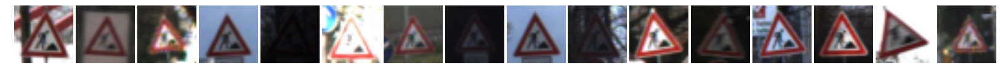

Class 26: Traffic signals                                                                  Number of images:540


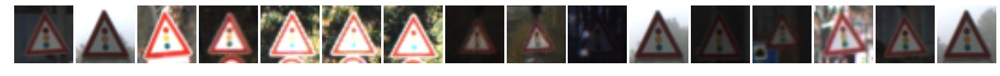

Class 27: Pedestrians                                                                      Number of images:210


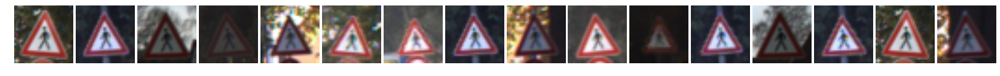

Class 28: Children crossing                                                                Number of images:480


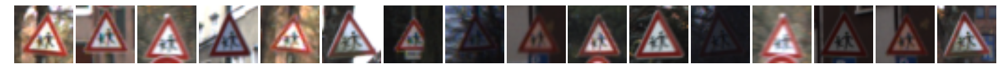

Class 29: Bicycles crossing                                                                Number of images:240


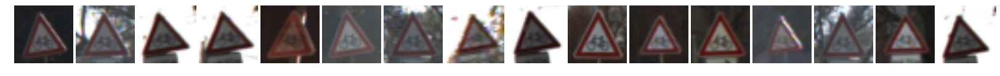

Class 30: Beware of ice/snow                                                               Number of images:390


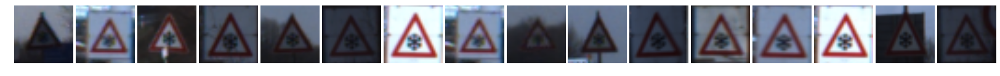

Class 31: Wild animals crossing                                                            Number of images:690


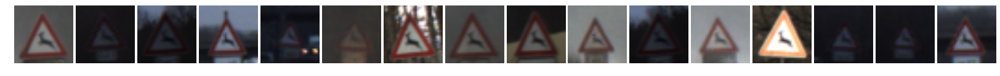

Class 32: End of all speed and passing limits                                              Number of images:210


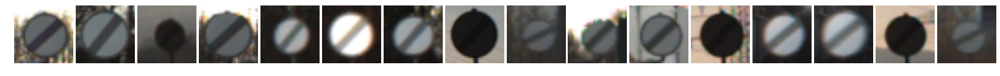

Class 33: Turn right ahead                                                                 Number of images:599


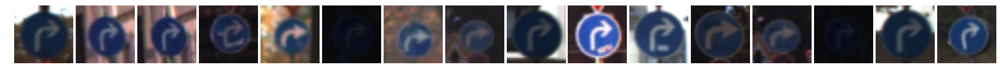

Class 34: Turn left ahead                                                                  Number of images:360


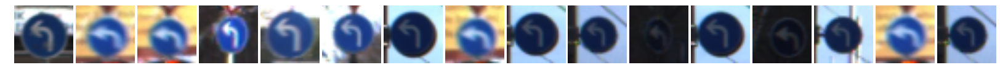

Class 35: Ahead only                                                                       Number of images:1080


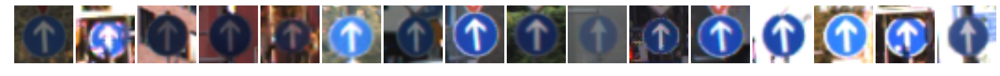

Class 36: Go straight or right                                                             Number of images:330


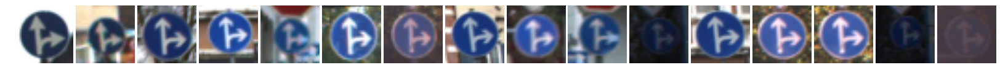

Class 37: Go straight or left                                                              Number of images:180


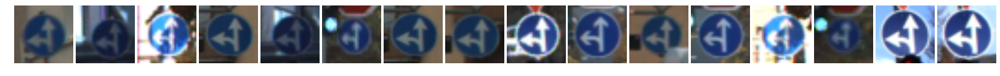

Class 38: Keep right                                                                       Number of images:1860


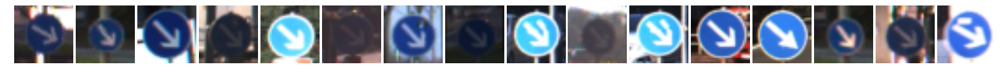

Class 39: Keep left                                                                        Number of images:270


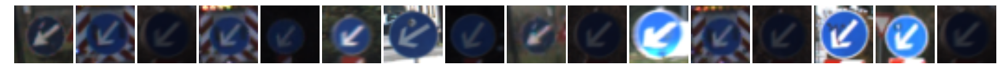

Class 40: Roundabout mandatory                                                             Number of images:300


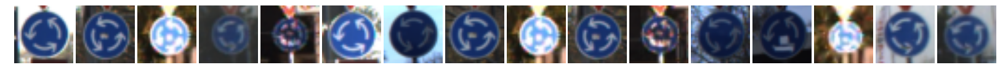

Class 41: End of no passing                                                                Number of images:210


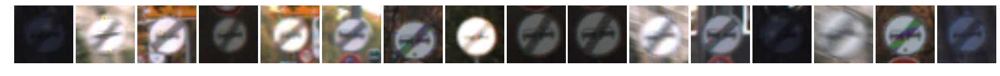

Class 42: End of no passing by vehicles over 3.5 metric tons                               Number of images:210


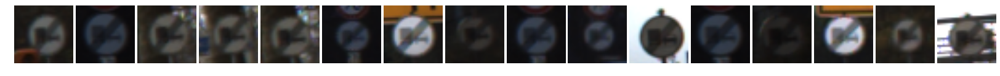

In [8]:
signnames = np.genfromtxt('signnames.csv', delimiter=',', dtype=np.str)
origin_x, origin_y = np.array([X_train[Y_train==c][:] for c in range(n_classes)]), \
                     np.array([Y_train[Y_train==c][:] for c in range(n_classes)])
cols = 16
for c in range(n_classes):
    count = origin_y[c].shape[0]
    indices = np.random.choice(count, cols)
    print("Class %s: %-80s Number of images:%s" % (signnames[c+1][0], signnames[c+1][1], count))
    images_show(1, cols, origin_x[c][indices])

----

## Step 2: Design and Test a Model Architecture

Design and implement a deep learning model that learns to recognize traffic signs. Train and test your model on the [German Traffic Sign Dataset](http://benchmark.ini.rub.de/?section=gtsrb&subsection=dataset).

The LeNet-5 implementation shown in the [classroom](https://classroom.udacity.com/nanodegrees/nd013/parts/fbf77062-5703-404e-b60c-95b78b2f3f9e/modules/6df7ae49-c61c-4bb2-a23e-6527e69209ec/lessons/601ae704-1035-4287-8b11-e2c2716217ad/concepts/d4aca031-508f-4e0b-b493-e7b706120f81) at the end of the CNN lesson is a solid starting point. You'll have to change the number of classes and possibly the preprocessing, but aside from that it's plug and play! 

With the LeNet-5 solution from the lecture, you should expect a validation set accuracy of about 0.89. To meet specifications, the validation set accuracy will need to be at least 0.93. It is possible to get an even higher accuracy, but 0.93 is the minimum for a successful project submission. 

There are various aspects to consider when thinking about this problem:

- Neural network architecture (is the network over or underfitting?)
- Play around preprocessing techniques (normalization, rgb to grayscale, etc)
- Number of examples per label (some have more than others).
- Generate fake data.

Here is an example of a [published baseline model on this problem](http://yann.lecun.com/exdb/publis/pdf/sermanet-ijcnn-11.pdf). It's not required to be familiar with the approach used in the paper but, it's good practice to try to read papers like these.

### Pre-process the Data Set (normalization, grayscale, etc.)

Minimally, the image data should be normalized so that the data has mean zero and equal variance. For image data, `(pixel - 128)/ 128` is a quick way to approximately normalize the data and can be used in this project. 

Other pre-processing steps are optional. You can try different techniques to see if it improves performance. 

Use the code cell (or multiple code cells, if necessary) to implement the first step of your project.

In [9]:
### Preprocess the data here. It is required to normalize the data. Other preprocessing steps could include 
import math
import tensorflow as tf
from skimage import exposure
import warnings
from tqdm import tqdm

def rotate_and_shift_image(input_data, angle, shift):
    
    images = tf.placeholder(tf.float32, (None, input_data.shape[1], input_data.shape[2], input_data.shape[3]))
    
    num_images = input_data.shape[0]
    # random rotate
    processed_images = tf.contrib.image.rotate(images, tf.random_uniform([num_images],
                                                               maxval=math.pi / 180 * angle,
                                                               minval=math.pi / 180 * -angle))
    # random shift
    base_row = tf.constant([1, 0, 0, 0, 1, 0, 0, 0], shape=[1, 8], dtype=tf.float32)
    base = tf.tile(base_row, [num_images, 1])
    mask_row = tf.constant([0, 1, 1, 0, 1, 1, 0, 0], shape=[1, 8], dtype=tf.float32)
    mask = tf.tile(mask_row, [num_images, 1])
    random_shift = tf.random_uniform([num_images, 8], minval=-shift, maxval=shift, dtype=tf.float32)
    transforms = base + random_shift * mask

    processed_images = tf.contrib.image.transform(images=processed_images, transforms=transforms)

    with tf.Session() as sess:
            processed_images = sess.run(processed_images, feed_dict = {images: input_data})
            
    return processed_images

def transform_images(images):
    num_images = images.shape[0]
    d = 0.15
    base_row = tf.constant([1, 0, 0, 0, 1, 0, 0, 0], shape=[1, 8], dtype=tf.float32)
    base = tf.tile(base_row, [num_images, 1])   
    angles = tf.random_uniform([num_images, 8], maxval=d, minval=-d)
    mask_row = tf.constant([1, 1, 1, 1, 0, 0, 0, 0], shape=[1, 8], dtype=tf.float32)
    mask = tf.tile(mask_row, [num_images, 1])
    angles = base + angles * mask
    transforms = tf.contrib.image.compose_transforms(angles)
#     angles = tf.random_uniform([num_images],maxval=math.pi / 180 * angle, minval=math.pi / 180 * -angle)
#     transforms = tf.contrib.image.angles_to_projective_transforms(angles, images.shape[1], images.shape[2])
    trans_images = tf.contrib.image.transform(images, transforms, interpolation='BILINEAR')
    with tf.Session() as sess:
        out = sess.run(trans_images)
    return out


def augment_images(x, y, stretch_factor=1, stretch=True, size=None):
    x = (x).astype(np.float32)
    x_ext = np.empty((0, x.shape[1], x.shape[2], x.shape[3]), dtype=np.float32)
    y_ext = np.empty((0), dtype=y.dtype)
    x_ext = np.append(x_ext, x, axis=0)
    y_ext = np.append(y_ext, y, axis=0)
    classes, class_counts = np.unique(y, return_counts = True)
    n_classes = classes.size
    max_c = max(class_counts)
    total = max_c if size is None else size
    with tqdm(total=n_classes) as pbar:
        for c, cnt in zip(classes, class_counts):
            if stretch:
                total = stretch_factor * cnt
            if total - cnt > 0:
                indices = np.random.choice(sum(y==c), total-cnt)
                x_ = x[y==c][indices]
                x_ = transform_images(x_)
                y_ = y[y==c][indices]
                x_ext = np.append(x_ext, x_, axis=0)
                y_ext = np.append(y_ext, y_, axis=0)
            else:
                continue
            pbar.update(1)
    return x_ext, y_ext
        
def rgb_to_grayscale(input):
    # convert to grayscale
    x = 0.299 * input[:, :, :, 0] + 0.587 * input[:, :, :, 1] + 0.114 * input[:, :, :, 2]
    # normalize
    x = (x / 256.).astype(np.float32)
    x = x.reshape(x.shape+(1,))
    return x

def enhence_single_image(image):
    x = 0.299 * image[:, :, 0] + 0.587 * image[:, :, 1] + 0.114 * image[:, :, 2]
    x = (x / 256.).astype(np.float32)
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        x = (exposure.equalize_adapthist(x) - 0.5)
    x = x.reshape(x.shape + (1,))
    return x

def enhence_images(images):
    images_out = np.empty((images.shape[0],images.shape[1],images.shape[2],1)).astype(np.float32)
    with tqdm(total=images.shape[0]) as pbar:
        for idx, image in enumerate(images):
            images_out[idx] = enhence_single_image(image)
            pbar.update(1)
    return images_out

def preprocess(x, y):
    x_enhence, y_enhence = enhence_images(x), y
    return x_enhence, y_enhence


----------------------Original Images---------------------


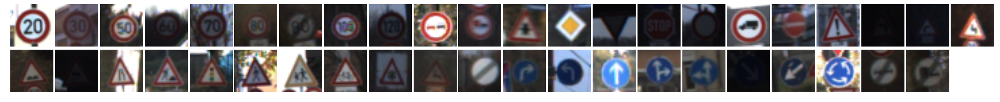

100%|██████████| 43/43 [00:00<00:00, 51.55it/s]


-----------------Original Enhenced Images-----------------


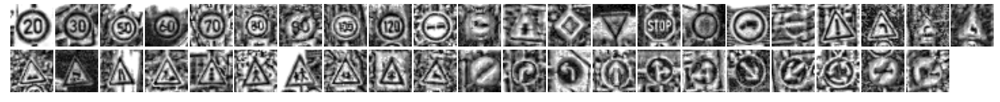

---------------------Transformed Images-------------------


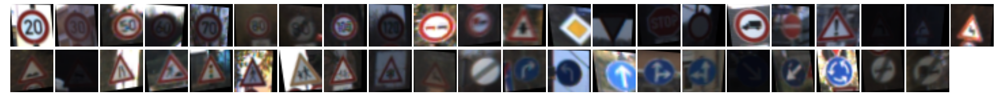

100%|██████████| 43/43 [00:00<00:00, 51.96it/s]


------------Transformed and Enhenced Images---------------


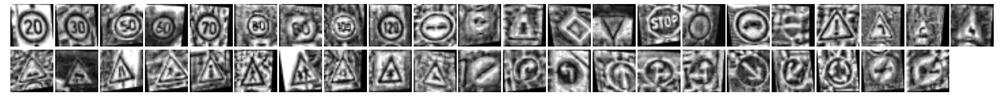

In [10]:
rows = 2
cols = 22
origin_x, origin_y = np.array([X_train[Y_train==c][10] for c in range(n_classes)]), \
                     np.array([Y_train[Y_train==c][10] for c in range(n_classes)])
print("----------------------Original Images---------------------")
images_show(rows, cols, origin_x)
origin_enhence = enhence_images(origin_x)
print("-----------------Original Enhenced Images-----------------")
images_show(rows, cols, origin_enhence, 'gray')
trans = transform_images(origin_x)
print("---------------------Transformed Images-------------------")
images_show(rows, cols, trans)
trans_enhence = enhence_images(trans)
print("------------Transformed and Enhenced Images---------------")
images_show(rows, cols, trans_enhence, 'gray')

In [42]:
x_ext, y_ext = augment_images(X_train, Y_train, 2)
print(x_ext.shape, y_ext.shape)

100%|██████████| 43/43 [01:11<00:00,  1.85s/it]

(69598, 32, 32, 3) (69598,)


In [45]:
x_train_ext_p, y_train_ext_p = preprocess(x_ext, y_ext)
x_valid_p, y_valid_p = preprocess(X_valid, Y_valid)
x_test_p, y_test_p = preprocess(X_test, Y_test)
# x_train_ext_p, y_train_ext_p = x_ext, y_ext
# x_valid_p, y_valid_p = X_valid, Y_valid
# x_test_p, y_test_p = X_test, Y_test

print(x_train_ext_p.shape)
print(y_train_ext_p.shape)
print(x_valid_p.shape)
print(y_valid_p.shape)
print(x_test_p.shape)
print(y_test_p.shape)

100%|██████████| 12630/12630 [03:56<00:00, 53.31it/s]

(69598, 32, 32, 1)
(69598,)
(4410, 32, 32, 1)
(4410,)
(12630, 32, 32, 1)
(12630,)


In [11]:
# x_train, y_train = X_train, Y_train
# x_valid, y_valid = X_valid, Y_valid
# x_test, y_test = X_test, Y_test

### Store Processed Images

In [48]:
training_p_file = "./traffic-signs-data/train_ext_p.p"
validation_p_file= "./traffic-signs-data/valid_p.p"
testing_p_file = "./traffic-signs-data/test_p.p"

In [49]:
dataset = {"features":x_train_ext_p.astype('float32'),"labels":y_train_ext_p}
with open(training_p_file, 'wb') as f:
    pickle.dump(dataset, f, protocol=pickle.HIGHEST_PROTOCOL)
del dataset

dataset = {"features":x_valid_p.astype('float32'),"labels":y_valid_p}
with open(validation_p_file, 'wb') as f:
    pickle.dump(dataset, f, protocol=pickle.HIGHEST_PROTOCOL)
del dataset

dataset = {"features":x_test_p.astype('float32'),"labels":y_test_p}
with open(testing_p_file, 'wb') as f:
    pickle.dump(dataset, f, protocol=pickle.HIGHEST_PROTOCOL)
del dataset


### Load Processed Images

In [12]:
training_p_file = "./traffic-signs-data/train_ext_p.p"
validation_p_file= "./traffic-signs-data/valid_p.p"
testing_p_file = "./traffic-signs-data/test_p.p"

with open(training_p_file, mode='rb') as f:
    train = pickle.load(f)
with open(validation_p_file, mode='rb') as f:
    valid = pickle.load(f)
with open(testing_p_file, mode='rb') as f:
    test = pickle.load(f)
    
x_train, y_train = train['features'], train['labels']
x_valid, y_valid = valid['features'], valid['labels']
x_test, y_test = test['features'], test['labels']

In [13]:
def show_all_classes_random_images(x, y, n_cols):
    signnames = np.genfromtxt('signnames.csv', delimiter=',', dtype=np.str)
    x_, y_ = np.array([x[y==c][:] for c in range(n_classes)]), \
                np.array([y[y==c][:] for c in range(n_classes)])
    cols = 16
    for c in range(n_classes):
        count = y_[c].shape[0]
        indices = np.random.choice(count, cols)
        print("Class %s: %-80s Number of images:%s" % (signnames[c+1][0], signnames[c+1][1], count))
        images_show(1, cols, x_[c][indices])

Class 0: Speed limit (20km/h)                                                             Number of images:360


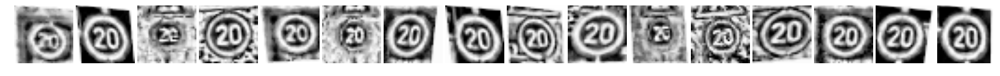

Class 1: Speed limit (30km/h)                                                             Number of images:3960


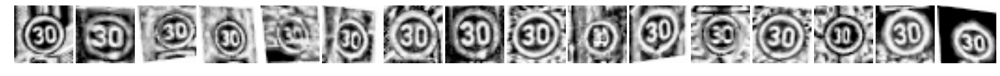

Class 2: Speed limit (50km/h)                                                             Number of images:4020


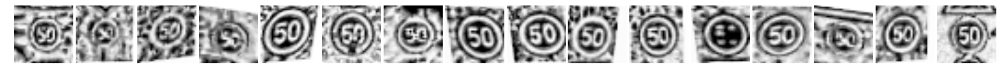

Class 3: Speed limit (60km/h)                                                             Number of images:2520


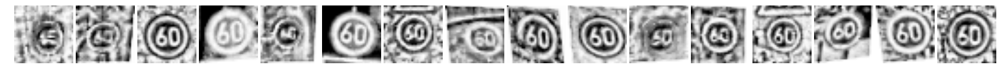

Class 4: Speed limit (70km/h)                                                             Number of images:3540


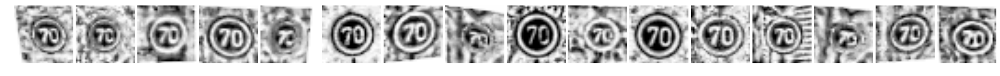

Class 5: Speed limit (80km/h)                                                             Number of images:3300


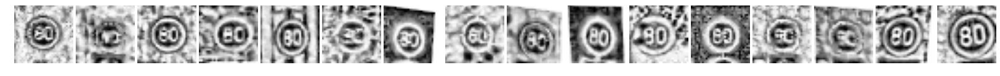

Class 6: End of speed limit (80km/h)                                                      Number of images:720


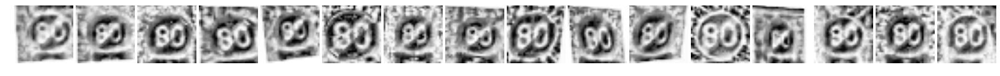

Class 7: Speed limit (100km/h)                                                            Number of images:2580


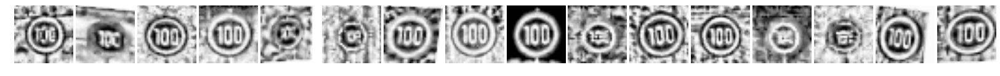

Class 8: Speed limit (120km/h)                                                            Number of images:2520


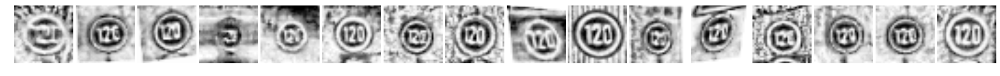

Class 9: No passing                                                                       Number of images:2640


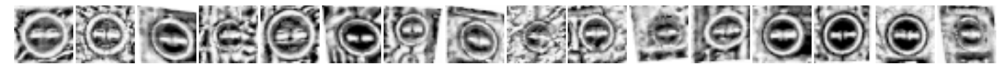

Class 10: No passing for vehicles over 3.5 metric tons                                     Number of images:3600


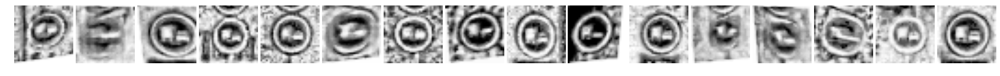

Class 11: Right-of-way at the next intersection                                            Number of images:2340


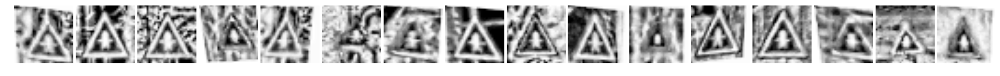

Class 12: Priority road                                                                    Number of images:3780


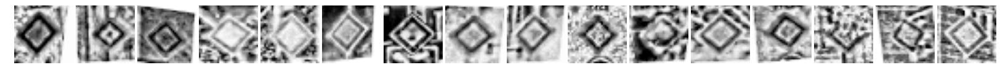

Class 13: Yield                                                                            Number of images:3840


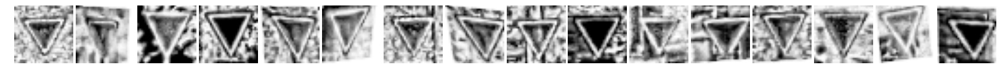

Class 14: Stop                                                                             Number of images:1380


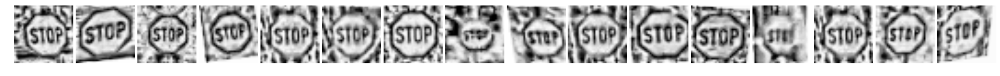

Class 15: No vehicles                                                                      Number of images:1080


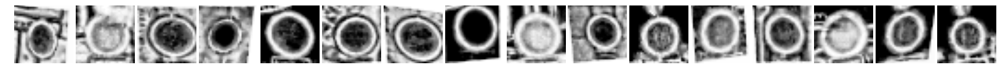

Class 16: Vehicles over 3.5 metric tons prohibited                                         Number of images:720


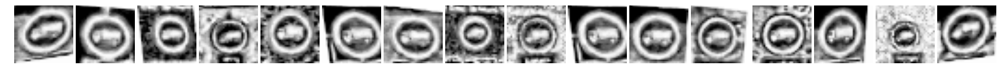

Class 17: No entry                                                                         Number of images:1980


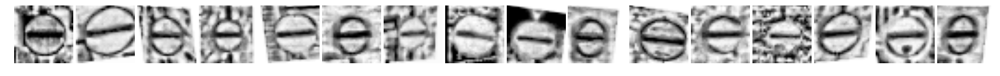

Class 18: General caution                                                                  Number of images:2160


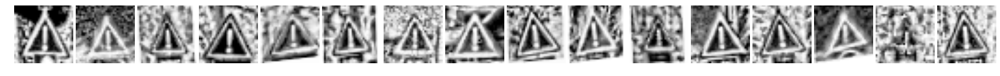

Class 19: Dangerous curve to the left                                                      Number of images:360


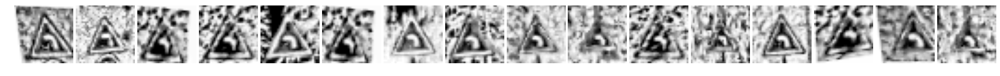

Class 20: Dangerous curve to the right                                                     Number of images:600


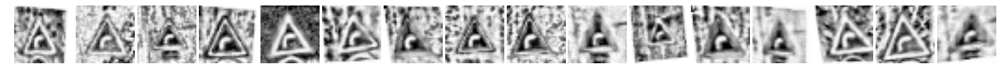

Class 21: Double curve                                                                     Number of images:540


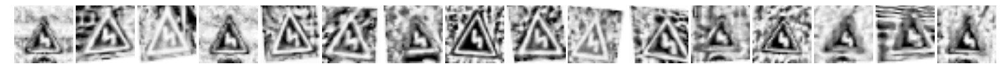

Class 22: Bumpy road                                                                       Number of images:660


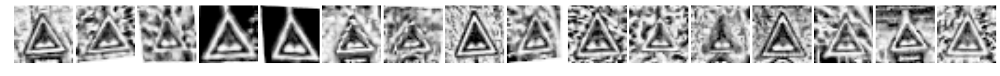

Class 23: Slippery road                                                                    Number of images:900


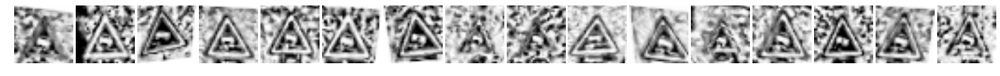

Class 24: Road narrows on the right                                                        Number of images:480


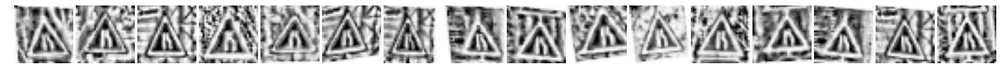

Class 25: Road work                                                                        Number of images:2700


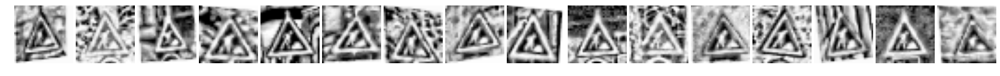

Class 26: Traffic signals                                                                  Number of images:1080


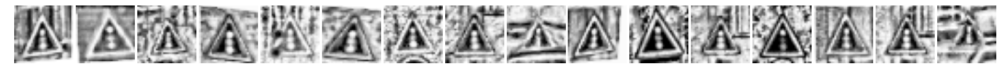

Class 27: Pedestrians                                                                      Number of images:420


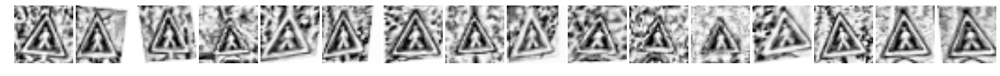

Class 28: Children crossing                                                                Number of images:960


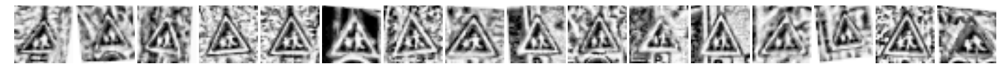

Class 29: Bicycles crossing                                                                Number of images:480


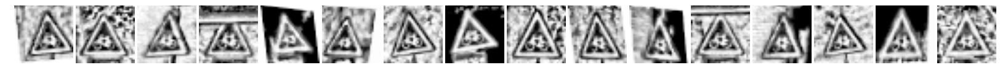

Class 30: Beware of ice/snow                                                               Number of images:780


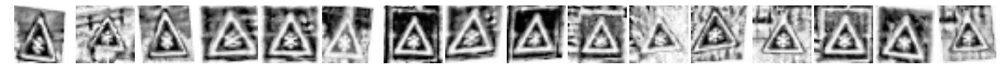

Class 31: Wild animals crossing                                                            Number of images:1380


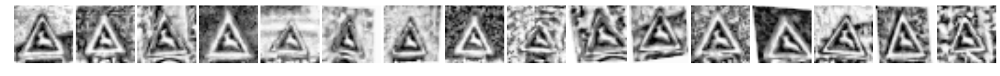

Class 32: End of all speed and passing limits                                              Number of images:420


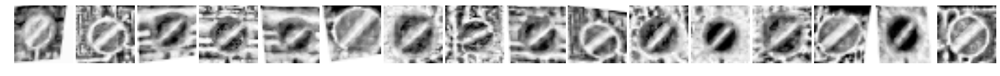

Class 33: Turn right ahead                                                                 Number of images:1198


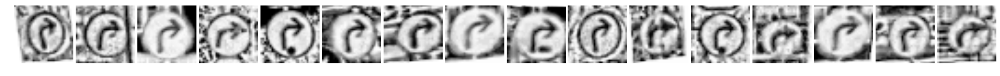

Class 34: Turn left ahead                                                                  Number of images:720


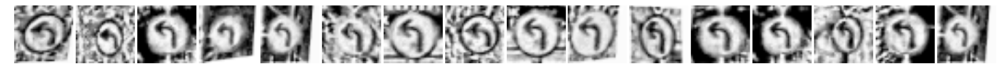

Class 35: Ahead only                                                                       Number of images:2160


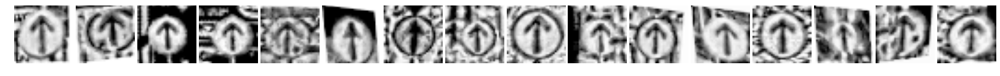

Class 36: Go straight or right                                                             Number of images:660


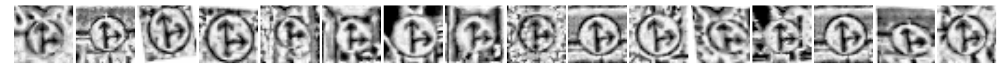

Class 37: Go straight or left                                                              Number of images:360


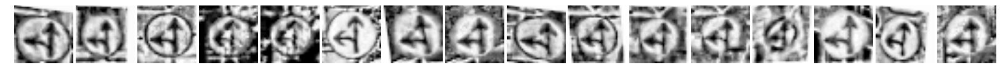

Class 38: Keep right                                                                       Number of images:3720


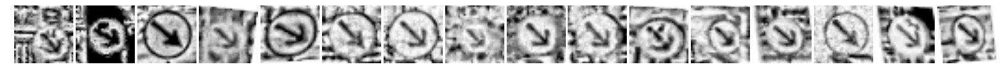

Class 39: Keep left                                                                        Number of images:540


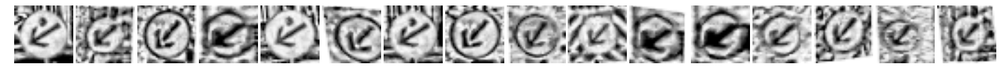

Class 40: Roundabout mandatory                                                             Number of images:600


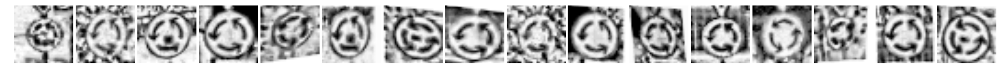

Class 41: End of no passing                                                                Number of images:420


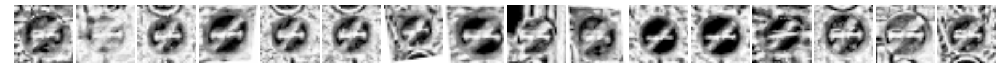

Class 42: End of no passing by vehicles over 3.5 metric tons                               Number of images:420


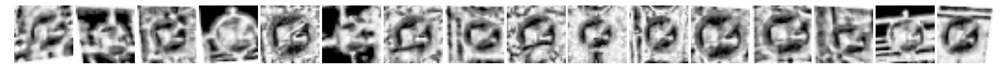

In [14]:
show_all_classes_random_images(x_train, y_train, 16)

### Model Architecture

In [15]:
### Define your architecture here.
### Feel free to use as many code cells as needed.
import tensorflow as tf

def max_pool(input, size, padding='VALID'):
    return tf.nn.max_pool(input, 
                          ksize = [1, size, size, 1], 
                          strides=[1, size, size, 1], 
                          padding=padding, name='pool')

def conv2d(input, kernel_size, stride, depth, padding='VALID', l2_lambda=1e-4):
    W = tf.get_variable('weights',
                        shape = [kernel_size, kernel_size, input.get_shape()[3], depth],
                        initializer = tf.contrib.layers.xavier_initializer())
    tf.add_to_collection('losses', tf.contrib.layers.l2_regularizer(l2_lambda)(W))
    b = tf.get_variable('bias', shape=[depth], initializer=tf.zeros_initializer())
    conv = tf.nn.conv2d(input=input, 
                        filter=W, strides=[1, stride, stride, 1], 
                        padding=padding, name='conv') #+ b
    return conv

def fully_connneted(input, out_units, l2_lambda=1e-4):
    W = tf.get_variable( 'weights',
                        shape = [input.get_shape()[1], out_units],
                        initializer = tf.contrib.layers.xavier_initializer())
    b = tf.get_variable('bias', shape=out_units, initializer=tf.zeros_initializer())
    tf.add_to_collection('losses', tf.contrib.layers.l2_regularizer(l2_lambda)(W))
    fc = tf.matmul(input, W, name='fully_connected') #+ b
    return fc

def activation(input):
#     return input * tf.sigmoid(input)
#     alpha = 0.2
#     return tf.maximum(alpha * input, input)
    return tf.nn.relu(input, name='activation')

In [54]:
tf.reset_default_graph()

def net(x, is_training=True, scale=1):
 
    with tf.variable_scope("conv1"):
        conv1 = conv2d(x, 5, 1, 6*scale)
#         conv1 = tf.cond(is_training, lambda: tf.nn.dropout(conv1, drop), lambda: conv1)
#         conv1 = tf.layers.batch_normalization(conv1, training=is_training)
        conv1 = activation(conv1)
        pool1 = max_pool(conv1, 2)   
        pool1 = tf.cond(is_training, lambda: tf.nn.dropout(pool1, 0.8), lambda: pool1)
        
    with tf.variable_scope("conv2"):
        conv2 = conv2d(pool1, 5, 1, 16*scale)
#         conv2 = tf.cond(is_training, lambda: tf.nn.dropout(conv2, 0.6), lambda: conv2)
        conv2 = tf.layers.batch_normalization(conv2, training=is_training)
        conv2 = activation(conv2)
        pool2 = max_pool(conv2, 2)
        pool2 = tf.cond(is_training, lambda: tf.nn.dropout(pool2, 0.7), lambda: pool2)
        
        
    pool1 = max_pool(pool1, 2)
    flat1 = tf.contrib.layers.flatten(pool1)
    flat2 = tf.contrib.layers.flatten(pool2)
    flat = tf.concat([flat1, flat2], 1)
    
    with tf.variable_scope("fc1"):
        fc1 = fully_connneted(flat, 120*scale)
        fc1 = tf.layers.batch_normalization(fc1, training=is_training)
        fc1 = activation(fc1)
        fc1 = tf.cond(is_training, lambda: tf.nn.dropout(fc1, 0.6), lambda: fc1)
        
    with tf.variable_scope("fc2"):
        fc2 = fully_connneted(fc1, 84*scale)
        fc2 = tf.layers.batch_normalization(fc2, training=is_training)
        fc2 = activation(fc2)
        fc2 = tf.cond(is_training, lambda: tf.nn.dropout(fc2, 0.5), lambda: fc2)
       

    logits = fully_connneted(fc2, n_classes)
    
   
    return logits

### Train, Validate and Test the Model

A validation set can be used to assess how well the model is performing. A low accuracy on the training and validation
sets imply underfitting. A high accuracy on the training set but low accuracy on the validation set implies overfitting.

In [55]:
### Train your model here.
### Calculate and report the accuracy on the training and validation set.
### Once a final model architecture is selected, 
### the accuracy on the test set should be calculated and reported as well.
### Feel free to use as many code cells as needed.
n_channel = x_train.shape[3]
x = tf.placeholder(tf.float32, (None, 32, 32, n_channel))
y = tf.placeholder(tf.int32, (None))
lr = tf.placeholder(tf.float32)
is_training = tf.placeholder(tf.bool)
one_hot_y = tf.one_hot(y, n_classes)

logits = net(x, is_training, 3)
cross_entropy = tf.nn.softmax_cross_entropy_with_logits(labels=one_hot_y, logits=logits)
loss = tf.reduce_mean(cross_entropy)
tf.add_to_collection('losses', loss)
total_loss = tf.add_n(tf.get_collection('losses'))
# total_loss = loss
with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
    training_operation = tf.train.AdamOptimizer(learning_rate=lr).minimize(total_loss)
# training_operation = tf.train.AdamOptimizer(learning_rate=lr).minimize(total_loss)

correct_pred = tf.equal(tf.argmax(logits, 1), tf.argmax(one_hot_y, 1))
accuracy_opt = tf.reduce_mean(tf.cast(correct_pred, tf.float32))
saver = tf.train.Saver()
save_model_path = './image_classification'

In [56]:
def evaluate(x_data, y_data):
    num_examples = len(x_data)
    total_accuracy = 0
    sess = tf.get_default_session()
    for offset in range(0, num_examples, BATCH_SIZE):
        batch_x, batch_y = x_data[offset:offset+BATCH_SIZE], y_data[offset:offset+BATCH_SIZE]
        accuracy = sess.run(accuracy_opt, feed_dict = {x: batch_x, y: batch_y, is_training: False})
        total_accuracy += (accuracy * len(batch_x))
    return total_accuracy / num_examples

In [57]:
def show_learning_curve(epochs, train, valid):
    plt.figure(figsize=(12, 6))
    plt.plot(epochs, train, label='train')
    plt.plot(epochs, valid, label='validation')
    plt.title('Learning Curve', fontsize=20)
    plt.ylabel('accuracy', fontsize=18)
    plt.xlabel('epochs', fontsize=18)
    plt.xticks(epochs)
    plt.legend(loc='upper left')

In [58]:
from sklearn.utils import shuffle

BATCH_SIZE = 128
EPOCHS = 100
learning_rate = [0.005, 0.003, 0.001, 0.0007, 0.0005, 0.0003, 0.0001, 0.00007, 0.00005, 0.00003, 0.00001, 0.000005]
learning_rate_idx = 0
decay_rate = learning_rate[learning_rate_idx]
learning_rate_idx += 1
with tf.Session() as sess:
    sess.run(tf.global_variables_initializer())
    num_examples = len(x_train)
    best = 0
    patience = 10
    patience_cnt = 0
    training_accuracys = []
    valid_accuracys = []
    epochs = []
    print("Training...")
    for epoch in range(EPOCHS):
        x_train, y_train = shuffle(x_train, y_train)
        batch_i = 0
        if patience_cnt > 1 and learning_rate_idx < len(learning_rate):
            decay_rate = learning_rate[learning_rate_idx]
            patience_cnt = 0
            learning_rate_idx += 1
#         print('learning_rate: ', decay_rate)
            
        for offset in range(0, num_examples, BATCH_SIZE):
            end = offset + BATCH_SIZE
            batch_x, batch_y = x_train[offset:end], y_train[offset:end]
            sess.run(training_operation, feed_dict = {x: batch_x, y: batch_y, lr: decay_rate, is_training: True})           
#             if batch_i % 10 == 0:
#                 training_loss = loss.eval({x: batch_x, y: batch_y, is_training: False})
#                 training_acc = accuracy_opt.eval({x: batch_x, y: batch_y, is_training: False})
#                 print('Epoch: {:>2}, Batch: {:>3},  Training Loss: {:>9.4f}, Training Accuracy: {:>9.6f}'\
#                       .format(epoch + 1, batch_i, training_loss, training_acc))
#             batch_i += 1
        valid_acc = evaluate(x_valid, y_valid)
        train_acc = evaluate(x_train, y_train)
        epochs.append(epoch+1)
        training_accuracys.append(train_acc)
        valid_accuracys.append(valid_acc)
        print('Epoch: {:>2}, Validation Accuracy: {:>9.6f}, Train Accuracy: {:>9.6f}, learning_rate:{:>9.6f}'.\
              format(epoch + 1, valid_acc, train_acc, decay_rate))
        if (valid_acc > best):
            best = valid_acc
            patience_cnt = 0
        else:
            patience_cnt += 1
        if patience_cnt > patience:
            print('early stopping')
            break;
    
    saver.save(sess, save_model_path)
    print("Model saved")

Training...
Epoch:  1, Validation Accuracy:  0.913832, Train Accuracy:  0.913360, learning_rate: 0.005000
Epoch:  2, Validation Accuracy:  0.969841, Train Accuracy:  0.968462, learning_rate: 0.005000
Epoch:  3, Validation Accuracy:  0.943991, Train Accuracy:  0.956809, learning_rate: 0.005000
Epoch:  4, Validation Accuracy:  0.955329, Train Accuracy:  0.971666, learning_rate: 0.005000
Epoch:  5, Validation Accuracy:  0.961224, Train Accuracy:  0.986336, learning_rate: 0.003000
Epoch:  6, Validation Accuracy:  0.973016, Train Accuracy:  0.986752, learning_rate: 0.003000
Epoch:  7, Validation Accuracy:  0.969388, Train Accuracy:  0.990546, learning_rate: 0.003000
Epoch:  8, Validation Accuracy:  0.966213, Train Accuracy:  0.983146, learning_rate: 0.003000
Epoch:  9, Validation Accuracy:  0.981179, Train Accuracy:  0.997155, learning_rate: 0.001000
Epoch: 10, Validation Accuracy:  0.985034, Train Accuracy:  0.998807, learning_rate: 0.001000
Epoch: 11, Validation Accuracy:  0.984580, Train

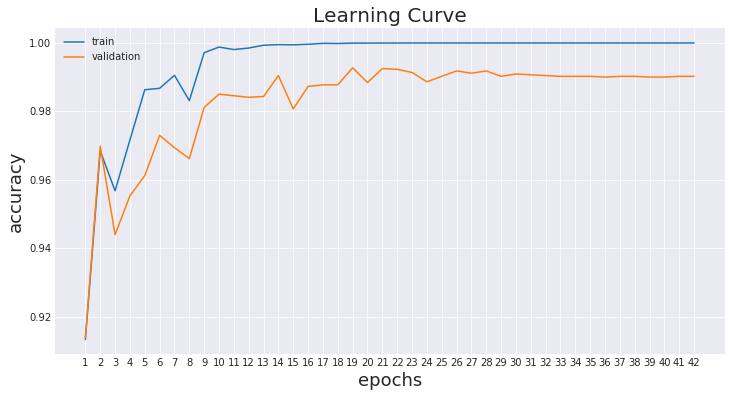

In [59]:
show_learning_curve(epochs, training_accuracys, valid_accuracys)

In [60]:
import tensorflow as tf
saver = tf.train.Saver()
save_model_path = './image_classification'

with tf.Session() as sess:
    saver.restore(sess, save_model_path)
    test_acc = evaluate(x_test, y_test)
    print('Test Accuracy: {:>9.6f}'.format(test_acc))
    pred = tf.argmax(logits, 1)
    y_pred = sess.run(pred, feed_dict={x: x_test, y: y_test, is_training: False})

INFO:tensorflow:Restoring parameters from ./image_classification
Test Accuracy:  0.979097


In [61]:
from sklearn import metrics
import numpy as np
from matplotlib import pyplot as plt

def plot_confusion_matrix(cm, target_names, title='Confusion matrix', cmap=plt.cm.Greys):
    plt.figure(figsize=(10,10))
    plt.imshow(cm, cmap=cmap)
    plt.title(title, fontsize=20)
    plt.colorbar()
    tick_marks = np.arange(len(target_names))
    plt.xticks(tick_marks, target_names)
    plt.yticks(tick_marks, target_names)
    plt.tight_layout()
    plt.ylabel('True label', fontsize=15)
    plt.xlabel('Predicted label', fontsize=15)

classify_report : 
              precision    recall  f1-score   support

          0       0.98      1.00      0.99        60
          1       0.99      0.99      0.99       720
          2       0.99      0.98      0.99       750
          3       0.98      0.94      0.96       450
          4       1.00      0.99      0.99       660
          5       0.88      1.00      0.94       630
          6       0.99      0.91      0.95       150
          7       0.99      0.99      0.99       450
          8       0.99      0.93      0.96       450
          9       0.98      1.00      0.99       480
         10       1.00      1.00      1.00       660
         11       0.97      0.98      0.98       420
         12       1.00      1.00      1.00       690
         13       1.00      1.00      1.00       720
         14       1.00      0.99      1.00       270
         15       0.99      1.00      0.99       210
         16       1.00      1.00      1.00       150
         17       1.00   

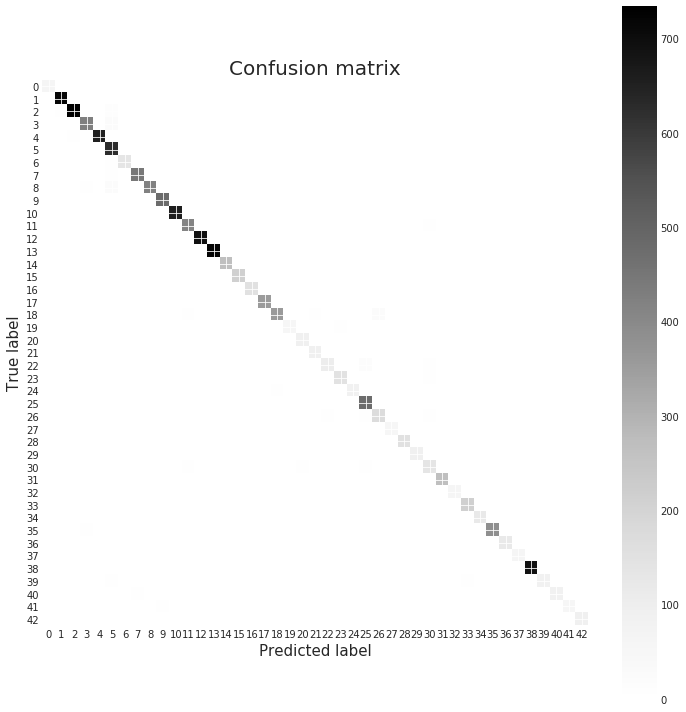

In [62]:
y_true = y_test
classify_report = metrics.classification_report(y_true, y_pred)
confusion_matrix = metrics.confusion_matrix(y_true, y_pred)
print('classify_report : \n', classify_report)
np.savetxt("confusion.csv", np.uint32(confusion_matrix), delimiter=' ')
plot_confusion_matrix(confusion_matrix, [i for i in range(43)])

---

## Step 3: Test a Model on New Images

To give yourself more insight into how your model is working, download at least five pictures of German traffic signs from the web and use your model to predict the traffic sign type.

You may find `signnames.csv` useful as it contains mappings from the class id (integer) to the actual sign name.

### Load and Output the Images

In [63]:
### Load the images and plot them here.
### Feel free to use as many code cells as needed.
from PIL import Image
import glob
test_pics_path = "./German-traffic-signs"
from PIL import Image 
import glob, os 
size = 32,32 
 
test_images = []
y_new = []
for infile in glob.glob("./German-traffic-signs/*.jpg"):
    file = os.path.basename(infile).split('.')[0]
    im = Image.open(infile)
    image = np.array(im.resize(size, Image.ANTIALIAS))
    test_images.append(image)
    y_new.append(np.uint8(file))
test_images = np.array(test_images)
y_new = np.array(y_new)

x_new = enhence_images(test_images)

100%|██████████| 18/18 [00:00<00:00, 52.75it/s]


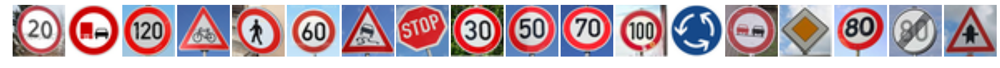

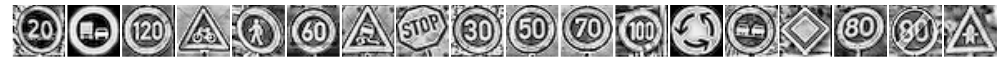

In [64]:
images_show(1, len(test_images), test_images)
images_show(1, len(x_new), x_new)

### Predict the Sign Type for Each Image

INFO:tensorflow:Restoring parameters from ./image_classification
Prediction Result:【Right】 
Origin:Speed limit (20km/h)           
Prediction:Speed limit (20km/h)          


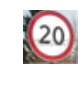

Prediction Result:【Right】 
Origin:No passing for vehicles over 3.5 metric tons 
Prediction:No passing for vehicles over 3.5 metric tons


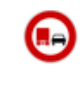

Prediction Result:【Wrong】 
Origin:Speed limit (120km/h)          
Prediction:Speed limit (20km/h)          


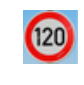

Prediction Result:【Right】 
Origin:Bicycles crossing              
Prediction:Bicycles crossing             


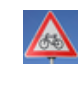

Prediction Result:【Right】 
Origin:Pedestrians                    
Prediction:Pedestrians                   


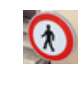

Prediction Result:【Right】 
Origin:Speed limit (60km/h)           
Prediction:Speed limit (60km/h)          


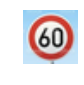

Prediction Result:【Right】 
Origin:Slippery road                  
Prediction:Slippery road                 


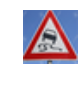

Prediction Result:【Right】 
Origin:Stop                           
Prediction:Stop                          


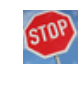

Prediction Result:【Right】 
Origin:Speed limit (30km/h)           
Prediction:Speed limit (30km/h)          


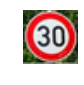

Prediction Result:【Right】 
Origin:Speed limit (50km/h)           
Prediction:Speed limit (50km/h)          


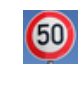

Prediction Result:【Right】 
Origin:Speed limit (70km/h)           
Prediction:Speed limit (70km/h)          


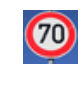

Prediction Result:【Right】 
Origin:Speed limit (100km/h)          
Prediction:Speed limit (100km/h)         


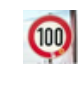

Prediction Result:【Right】 
Origin:Roundabout mandatory           
Prediction:Roundabout mandatory          


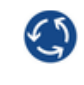

Prediction Result:【Right】 
Origin:No passing                     
Prediction:No passing                    


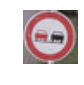

Prediction Result:【Right】 
Origin:Priority road                  
Prediction:Priority road                 


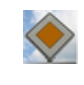

Prediction Result:【Right】 
Origin:Speed limit (80km/h)           
Prediction:Speed limit (80km/h)          


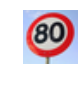

Prediction Result:【Right】 
Origin:End of speed limit (80km/h)    
Prediction:End of speed limit (80km/h)   


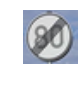

Prediction Result:【Right】 
Origin:Right-of-way at the next intersection 
Prediction:Right-of-way at the next intersection


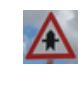

In [65]:
### Run the predictions here and use the model to output the prediction for each image.
### Make sure to pre-process the images with the same pre-processing pipeline used earlier.
### Feel free to use as many code cells as needed.
import tensorflow as tf

signnames = np.genfromtxt('signnames.csv', delimiter=',', dtype=np.str)

saver = tf.train.Saver()
save_model_path = './image_classification'
with tf.Session() as sess:
    saver.restore(sess, save_model_path)
    pred = tf.argmax(logits, 1)
    y_new_pred = sess.run(pred, feed_dict={x: x_new, is_training: False})

    for idx in range(len(y_new)):
        c_new = y_new[idx]
        c_pred = y_new_pred[idx]
        is_same ="Right" if c_new == c_pred  else "Wrong"
        print("Prediction Result:【{:<5s}】 \nOrigin:{:<30s} \nPrediction:{:<30s}".\
              format(is_same, signnames[c_new+1][1], signnames[c_pred+1][1]))
        plt.figure(figsize=(1,1))
        plt.imshow(test_images[idx], interpolation="BILINEAR")
        plt.axis('off')
        plt.show()
        
    

### Analyze Performance

In [66]:
### Calculate the accuracy for these 5 new images. 
### For example, if the model predicted 1 out of 5 signs correctly, it's 20% accurate on these new images.
with tf.Session() as sess:
    saver.restore(sess, save_model_path)
    test_acc = evaluate(x_new, y_new)
    print('Test Accuracy: {:>9.6f}'.format(test_acc))

INFO:tensorflow:Restoring parameters from ./image_classification
Test Accuracy:  0.944444


### Output Top 5 Softmax Probabilities For Each Image Found on the Web

For each of the new images, print out the model's softmax probabilities to show the **certainty** of the model's predictions (limit the output to the top 5 probabilities for each image). [`tf.nn.top_k`](https://www.tensorflow.org/versions/r0.12/api_docs/python/nn.html#top_k) could prove helpful here. 

The example below demonstrates how tf.nn.top_k can be used to find the top k predictions for each image.

`tf.nn.top_k` will return the values and indices (class ids) of the top k predictions. So if k=3, for each sign, it'll return the 3 largest probabilities (out of a possible 43) and the correspoding class ids.

Take this numpy array as an example. The values in the array represent predictions. The array contains softmax probabilities for five candidate images with six possible classes. `tf.nn.top_k` is used to choose the three classes with the highest probability:

```
# (5, 6) array
a = np.array([[ 0.24879643,  0.07032244,  0.12641572,  0.34763842,  0.07893497,
         0.12789202],
       [ 0.28086119,  0.27569815,  0.08594638,  0.0178669 ,  0.18063401,
         0.15899337],
       [ 0.26076848,  0.23664738,  0.08020603,  0.07001922,  0.1134371 ,
         0.23892179],
       [ 0.11943333,  0.29198961,  0.02605103,  0.26234032,  0.1351348 ,
         0.16505091],
       [ 0.09561176,  0.34396535,  0.0643941 ,  0.16240774,  0.24206137,
         0.09155967]])
```

Running it through `sess.run(tf.nn.top_k(tf.constant(a), k=3))` produces:

```
TopKV2(values=array([[ 0.34763842,  0.24879643,  0.12789202],
       [ 0.28086119,  0.27569815,  0.18063401],
       [ 0.26076848,  0.23892179,  0.23664738],
       [ 0.29198961,  0.26234032,  0.16505091],
       [ 0.34396535,  0.24206137,  0.16240774]]), indices=array([[3, 0, 5],
       [0, 1, 4],
       [0, 5, 1],
       [1, 3, 5],
       [1, 4, 3]], dtype=int32))
```

Looking just at the first row we get `[ 0.34763842,  0.24879643,  0.12789202]`, you can confirm these are the 3 largest probabilities in `a`. You'll also notice `[3, 0, 5]` are the corresponding indices.

In [67]:
### Print out the top five softmax probabilities for the predictions on the German traffic sign images found on the web. 
### Feel free to use as many code cells as needed.
with tf.Session() as sess:
    saver.restore(sess, save_model_path)
    new_logits = tf.nn.softmax(logits)
    top_k = sess.run(tf.nn.top_k(new_logits, k=5), feed_dict={x: x_new, is_training: False})

INFO:tensorflow:Restoring parameters from ./image_classification


++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【 0】: Speed limit (20km/h)                               99.730420%
【20】: Dangerous curve to the right                        0.080587%
【 8】: Speed limit (120km/h)                               0.069766%
【16】: Vehicles over 3.5 metric tons prohibited            0.060786%
【 3】: Speed limit (60km/h)                                0.033363%


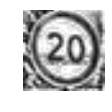

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【10】: No passing for vehicles over 3.5 metric tons       99.999332%
【42】: End of no passing by vehicles over 3.5 metric tons  0.000640%
【 9】: No passing                                          0.000014%
【 7】: Speed limit (100km/h)                               0.000003%
【38】: Keep right                                          0.000003%


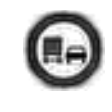

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【 0】: Speed limit (20km/h)                               98.523223%
【 8】: Speed limit (120km/h)                               1.336176%
【 3】: Speed limit (60km/h)                                0.083329%
【20】: Dangerous curve to the right                        0.022704%
【 4】: Speed limit (70km/h)                                0.011854%


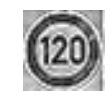

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【29】: Bicycles crossing                                  97.889692%
【30】: Beware of ice/snow                                  2.104313%
【28】: Children crossing                                   0.002974%
【23】: Slippery road                                       0.001729%
【22】: Bumpy road                                          0.000903%


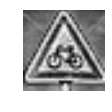

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【27】: Pedestrians                                        29.136255%
【40】: Roundabout mandatory                               21.825555%
【 3】: Speed limit (60km/h)                               16.562875%
【 4】: Speed limit (70km/h)                                6.918275%
【 1】: Speed limit (30km/h)                                5.187795%


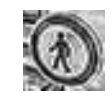

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【 3】: Speed limit (60km/h)                               99.999762%
【 5】: Speed limit (80km/h)                                0.000123%
【 2】: Speed limit (50km/h)                                0.000042%
【35】: Ahead only                                          0.000027%
【 9】: No passing                                          0.000017%


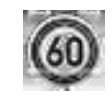

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【23】: Slippery road                                      99.765766%
【29】: Bicycles crossing                                   0.182731%
【30】: Beware of ice/snow                                  0.041972%
【31】: Wild animals crossing                               0.004404%
【 5】: Speed limit (80km/h)                                0.002237%


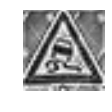

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【14】: Stop                                               99.988043%
【18】: General caution                                     0.003058%
【 5】: Speed limit (80km/h)                                0.002098%
【 7】: Speed limit (100km/h)                               0.001196%
【34】: Turn left ahead                                     0.000976%


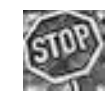

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【 1】: Speed limit (30km/h)                               99.945384%
【 5】: Speed limit (80km/h)                                0.037421%
【 0】: Speed limit (20km/h)                                0.004232%
【 4】: Speed limit (70km/h)                                0.003924%
【 2】: Speed limit (50km/h)                                0.003622%


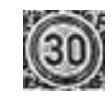

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【 2】: Speed limit (50km/h)                               69.322205%
【 1】: Speed limit (30km/h)                               21.173958%
【 5】: Speed limit (80km/h)                                7.855766%
【 6】: End of speed limit (80km/h)                         0.509553%
【 4】: Speed limit (70km/h)                                0.316597%


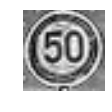

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【 4】: Speed limit (70km/h)                               98.717517%
【 3】: Speed limit (60km/h)                                0.329748%
【 1】: Speed limit (30km/h)                                0.302937%
【 0】: Speed limit (20km/h)                                0.239995%
【15】: No vehicles                                         0.117035%


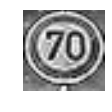

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【 7】: Speed limit (100km/h)                              99.993145%
【 1】: Speed limit (30km/h)                                0.006774%
【 5】: Speed limit (80km/h)                                0.000030%
【 8】: Speed limit (120km/h)                               0.000024%
【40】: Roundabout mandatory                                0.000008%


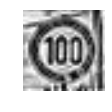

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【40】: Roundabout mandatory                               99.998105%
【16】: Vehicles over 3.5 metric tons prohibited            0.000713%
【17】: No entry                                            0.000470%
【12】: Priority road                                       0.000403%
【37】: Go straight or left                                 0.000114%


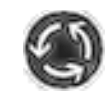

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【 9】: No passing                                         99.885404%
【 3】: Speed limit (60km/h)                                0.074975%
【16】: Vehicles over 3.5 metric tons prohibited            0.013940%
【10】: No passing for vehicles over 3.5 metric tons        0.011958%
【15】: No vehicles                                         0.003454%


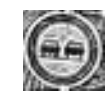

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【12】: Priority road                                      100.000000%
【39】: Keep left                                           0.000000%
【32】: End of all speed and passing limits                 0.000000%
【17】: No entry                                            0.000000%
【38】: Keep right                                          0.000000%


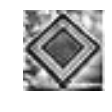

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【 5】: Speed limit (80km/h)                               96.223599%
【 1】: Speed limit (30km/h)                                2.447361%
【 3】: Speed limit (60km/h)                                0.541886%
【38】: Keep right                                          0.171504%
【 6】: End of speed limit (80km/h)                         0.130937%


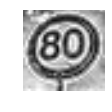

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【 6】: End of speed limit (80km/h)                        99.990010%
【 1】: Speed limit (30km/h)                                0.003649%
【42】: End of no passing by vehicles over 3.5 metric tons  0.001858%
【 5】: Speed limit (80km/h)                                0.001585%
【32】: End of all speed and passing limits                 0.000891%


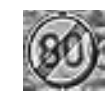

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
【11】: Right-of-way at the next intersection              97.104102%
【30】: Beware of ice/snow                                  1.444852%
【27】: Pedestrians                                         0.773976%
【28】: Children crossing                                   0.540805%
【25】: Road work                                           0.028722%


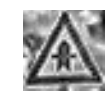

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++


In [76]:
top_k_prob = top_k.values
top_k_pred = top_k.indices

print('+' * 70)
for i, (preds, probs, image) in enumerate(zip(top_k_pred, top_k_prob, x_new)): 
    for pred, prob in zip(preds, probs):
        sign_name = signnames[pred+1][1]
        print('【{:>2}】: {:<50s} {:>9.6f}%'.format(pred, sign_name, prob*100.))
    plt.figure(figsize=(1.5,1.5))
    if image.shape[-1] == 1:
        image = image.reshape(image.shape[0], image.shape[1])
        plt.imshow(image, interpolation="BILINEAR", cmap='gray')
    else:
        plt.imshow(image, interpolation="BILINEAR")
    plt.axis('off')
    plt.show() 
    print('+' * 70) 

### Project Writeup

Once you have completed the code implementation, document your results in a project writeup using this [template](https://github.com/udacity/CarND-Traffic-Sign-Classifier-Project/blob/master/writeup_template.md) as a guide. The writeup can be in a markdown or pdf file. 

> **Note**: Once you have completed all of the code implementations and successfully answered each question above, you may finalize your work by exporting the iPython Notebook as an HTML document. You can do this by using the menu above and navigating to  \n",
    "**File -> Download as -> HTML (.html)**. Include the finished document along with this notebook as your submission.

---

## Step 4 (Optional): Visualize the Neural Network's State with Test Images

 This Section is not required to complete but acts as an additional excersise for understaning the output of a neural network's weights. While neural networks can be a great learning device they are often referred to as a black box. We can understand what the weights of a neural network look like better by plotting their feature maps. After successfully training your neural network you can see what it's feature maps look like by plotting the output of the network's weight layers in response to a test stimuli image. From these plotted feature maps, it's possible to see what characteristics of an image the network finds interesting. For a sign, maybe the inner network feature maps react with high activation to the sign's boundary outline or to the contrast in the sign's painted symbol.

 Provided for you below is the function code that allows you to get the visualization output of any tensorflow weight layer you want. The inputs to the function should be a stimuli image, one used during training or a new one you provided, and then the tensorflow variable name that represents the layer's state during the training process, for instance if you wanted to see what the [LeNet lab's](https://classroom.udacity.com/nanodegrees/nd013/parts/fbf77062-5703-404e-b60c-95b78b2f3f9e/modules/6df7ae49-c61c-4bb2-a23e-6527e69209ec/lessons/601ae704-1035-4287-8b11-e2c2716217ad/concepts/d4aca031-508f-4e0b-b493-e7b706120f81) feature maps looked like for it's second convolutional layer you could enter conv2 as the tf_activation variable.

For an example of what feature map outputs look like, check out NVIDIA's results in their paper [End-to-End Deep Learning for Self-Driving Cars](https://devblogs.nvidia.com/parallelforall/deep-learning-self-driving-cars/) in the section Visualization of internal CNN State. NVIDIA was able to show that their network's inner weights had high activations to road boundary lines by comparing feature maps from an image with a clear path to one without. Try experimenting with a similar test to show that your trained network's weights are looking for interesting features, whether it's looking at differences in feature maps from images with or without a sign, or even what feature maps look like in a trained network vs a completely untrained one on the same sign image.

<figure>
 <img src="visualize_cnn.png" width="380" alt="Combined Image" />
 <figcaption>
 <p></p> 
 <p style="text-align: center;"> Your output should look something like this (above)</p> 
 </figcaption>
</figure>
 <p></p> 


In [77]:
### Visualize your network's feature maps here.
### Feel free to use as many code cells as needed.

# image_input: the test image being fed into the network to produce the feature maps
# tf_activation: should be a tf variable name used during your training procedure that represents the calculated state of a specific weight layer
# activation_min/max: can be used to view the activation contrast in more detail, by default matplot sets min and max to the actual min and max values of the output
# plt_num: used to plot out multiple different weight feature map sets on the same block, just extend the plt number for each new feature map entry

def outputFeatureMap(image_input, tf_activation, activation_min=-1, activation_max=-1 ,plt_num=1):
    # Here make sure to preprocess your image_input in a way your network expects
    # with size, normalization, ect if needed
#     image_input = preprocess(image_input)
    # Note: x should be the same name as your network's tensorflow data placeholder variable
    # If you get an error tf_activation is not defined it may be having trouble accessing the variable from inside a function
    activation = tf_activation.eval(session=sess,feed_dict={x: image_input, is_training:False})
    featuremaps = activation.shape[3]
    plt.figure(plt_num, figsize=(20,20))
    for featuremap in range(featuremaps):
        plt.subplot(9,8, featuremap+1) # sets the number of feature maps to show on each row and column
        plt.title('FeatureMap ' + str(featuremap)) # displays the feature map number
        if activation_min != -1 & activation_max != -1:
            plt.imshow(activation[0,:,:, featuremap], interpolation="nearest", vmin =activation_min, vmax=activation_max, cmap="gray")
        elif activation_max != -1:
            plt.imshow(activation[0,:,:, featuremap], interpolation="nearest", vmax=activation_max, cmap="gray")
        elif activation_min !=-1:
            plt.imshow(activation[0,:,:, featuremap], interpolation="nearest", vmin=activation_min, cmap="gray")
        else:
            plt.imshow(activation[0,:,:, featuremap], interpolation="BILINEAR", cmap="gray")
        plt.axis('off')

INFO:tensorflow:Restoring parameters from ./image_classification


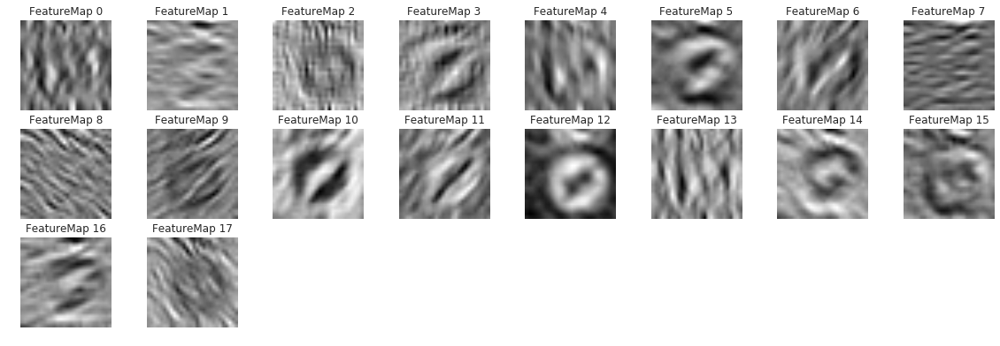

In [82]:
activation_name = "conv1/conv:0"
with tf.Session() as sess:
    saver.restore(sess, save_model_path)
    tf_activation = tf.get_default_graph().get_tensor_by_name(activation_name)
    outputFeatureMap(x_valid, tf_activation, activation_min=-1, activation_max=-1 ,plt_num=1)

INFO:tensorflow:Restoring parameters from ./image_classification


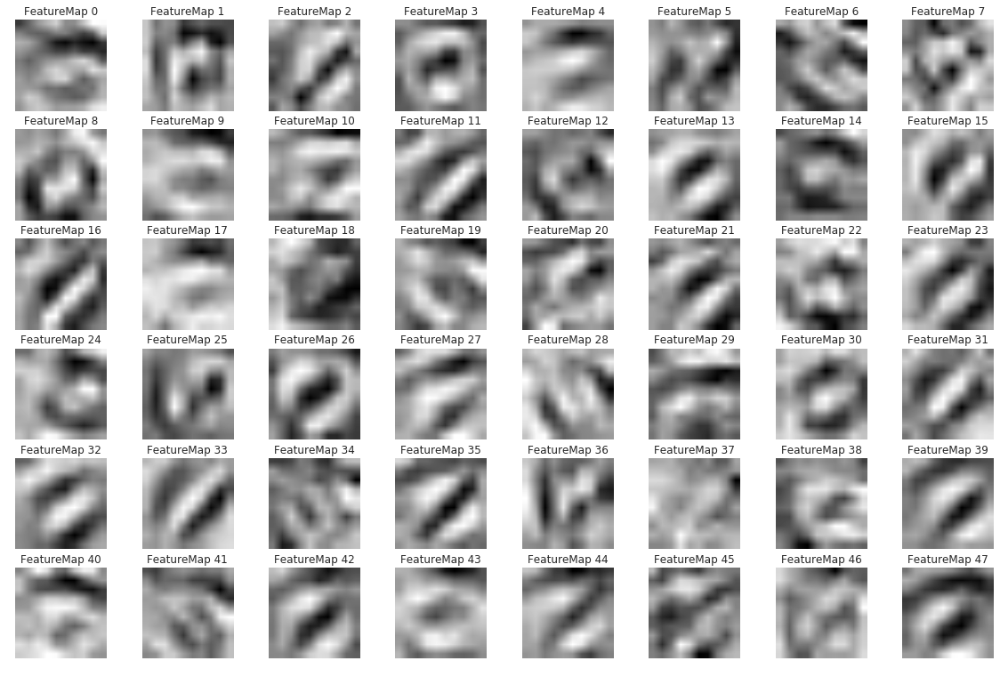

In [83]:
activation_name = "conv2/conv:0"
with tf.Session() as sess:
    saver.restore(sess, save_model_path)
    tf_activation = tf.get_default_graph().get_tensor_by_name(activation_name)
    outputFeatureMap(x_valid, tf_activation, activation_min=-1, activation_max=-1 ,plt_num=1)